In [1]:
import sys
sys.path.insert(0, '../../vector_field/velvet_ecosystem/velvet/')
import velvet as vt

import scvelo as scv
import scanpy as sc
import scFates as scf

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from sklearn.decomposition import PCA
from scipy.sparse import issparse
from tqdm import tqdm, trange

from cellrank.tl.kernels import PseudotimeKernel


/camp/home/maizelr/.local/lib/python3.8/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: /camp/home/maizelr/.local/lib/python3.8/site-packages/torchvision/image.so: undefined symbol: _ZN3c106detail19maybe_wrap_dim_slowEllb
  warn(f"Failed to load image Python extension: {e}")
Global seed set to 0
/camp/home/maizelr/.local/lib/python3.8/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/camp/home/maizelr/.local/lib/python3.8/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_exp

# Labelling Data

In [2]:
adata0 = vt.pp.read("../data/celltyped_adata.h5ad")
adata0 = adata0[adata0.obs.cell_annotation!='other']

In [3]:
def process_for_pseudotime(adata, layer, n_neighbors=50):
    X = adata.layers[layer]
    X = X.A if issparse(X) else X
    
    Xlog = np.log1p(X)
    pca = PCA()
    Xpca = pca.fit_transform(Xlog)
    adata.obsm['X_pca'] = Xpca
    adata.varm['precomputed_PCs'] = pca.components_
    
    if n_neighbors > 0:
        cnx = vt.pp.connectivities(total=X, n_neighbors=n_neighbors)
        Xsmooth = vt.pp.moments(total=X, connectivities=cnx, n_neighbors=n_neighbors)
        Xlogsmooth = np.log1p(Xsmooth)
        pca = PCA()
        Xpcasmooth = pca.fit_transform(Xlogsmooth)
        adata.obsm['X_pca_smooth'] = Xpcasmooth
    else:
        adata.obsm['X_pca_smooth'] = Xpca
    return adata

def run_tree(
    adata, 
    layer,
    n_nodes=200,
    seed=1,
    ppt_lambda=50,
    ppt_sigma=1.5,
    ndims_rep=50,
    figsize=(9,4),
    color='cell_annotation'
    ):
    scf.tl.tree(adata, method="ppt",Nodes=n_nodes, use_rep="X_pca_smooth",
                device="cpu",seed=seed,ppt_lambda=ppt_lambda,ppt_sigma=ppt_sigma,
                ppt_nsteps=300, ndims_rep=ndims_rep)
    fig = plt.figure(figsize=figsize)
    ax1, ax2 = fig.subplots(1,2)
    scf.pl.graph(adata, size=50, color_cells=color, basis='pca', 
                 ax=ax1, dimensions=[0,1], show=False, forks=False)
    scf.pl.graph(adata, size=50, color_cells=color, basis='pca', 
                 ax=ax2, dimensions=[0,2], show=False, forks=False)
    print(f"Tips: {adata.uns['graph']['tips']}")
    print()
    print(f"Forks: {adata.uns['graph']['forks']}")
    plt.show()

def run_pseudotime(adata, root, n_maps=10):    
    scf.tl.root(
        adata,
        root
    )

    scf.tl.pseudotime(
        adata,
        n_jobs=20,
        n_map=n_maps,
        seed=42
    )
    adata.obs['seg'] = adata.obs['seg'].astype('category')
    scf.pl.trajectory(adata, basis='pca', color_cells='seg')

def get_cell_pseudotime_vector(adata, cell_idx, basis='pca', ndim=50):
    idx = adata.uns['graph']['pp_info'].sort_values('time').PP.values
    points = adata.uns['graph']['F'].T[idx]
    segs = adata.uns['graph']['pp_info'].seg.values[idx]
    
    
    cell = adata[cell_idx]
    cell_rep = cell.obsm[f'X_{basis}'][:,:ndim]
    cell_seg = cell.obs.seg.values[0]
    
    seg_points = points[segs==cell_seg][:,:ndim]
    best = np.sqrt(np.sum((cell_rep - seg_points)**2, axis=1)).argmin()
    try:
        vector = seg_points[best+1] - seg_points[best]
    except IndexError:
        vector = np.zeros_like(seg_points[best])
    return vector

def calculate_pseudotime_vectorfield(adata, ndim=50, basis='pca'):
    vf = np.zeros_like(adata.obsm[f"X_{basis}"][:,:ndim])
    for i in trange(adata.shape[0]):
        vf[i,:] = get_cell_pseudotime_vector(adata, cell_idx=i, basis=basis, ndim=ndim)
    adata.obsm['velocity_pst'] = vf
    adata.obsm['X_pst'] = adata.obsm[f"X_{basis}"][:,:ndim]
    
def viz(adata, genes):
    """
    we don't want to keep the log transformed data or PCA, but want to viz
    """
    copy = adata.copy()    
    sc.pp.log1p(copy)
    sc.pp.pca(copy)
    sc.pl.pca(copy, color=['cell_annotation','timepoint','rep'])
    
def calculate_cellrank_vectorfield(adata, ndim=50, basis='pca'):
    cnx = vt.pp.connectivities(total=adata.layers['total'], n_neighbors=30)
    adata.obsp['neighbors_connectivities'] = cnx
    pk = PseudotimeKernel(adata, time_key='t')
    pk.compute_transition_matrix()
    pk.compute_projection(basis='pca', key_added='velocity_cr')
    adata.obsm['X_cr_pca'] = adata.obsm[f"X_{basis}"][:,:ndim]

### 1. mini

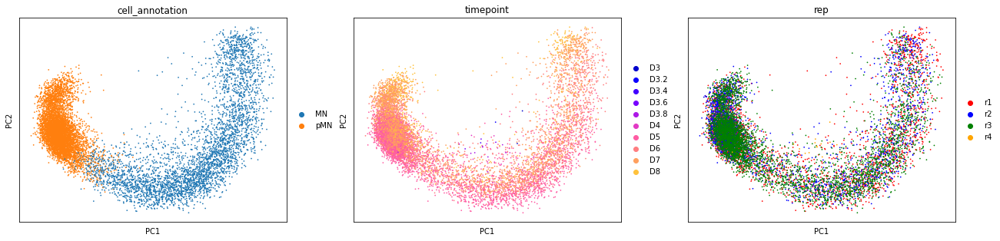

In [4]:
### 1. MN

types = ['MN', 'pMN']

adata = adata0[[ct in types for ct in adata0.obs.cell_annotation]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total')

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

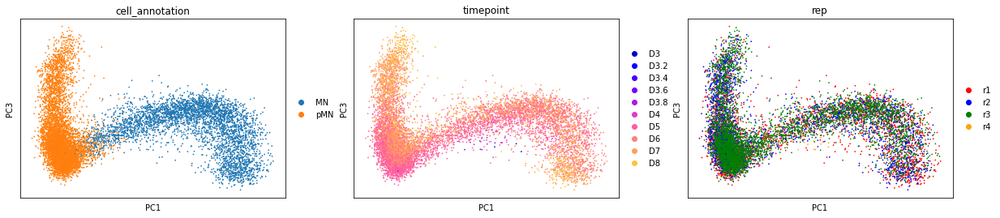

In [5]:
sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'], components='1,3')

inferring a principal tree --> parameters used 
    100 principal points, sigma = 3.25, lambda = 101, metric = euclidean
    fitting:   9%|▉         | 27/300 [00:05<00:54,  5.04it/s]
    converged
    finished (0:00:05) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.
Tips: [44 62 81]

Forks: [24]


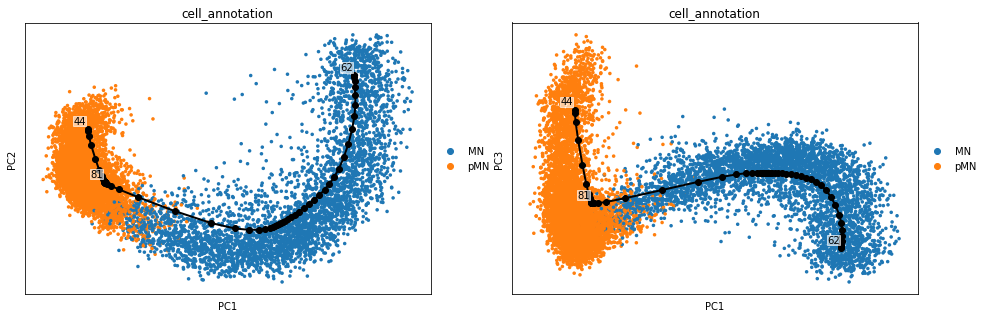

In [7]:
run_tree(
    adata, 
    'total',
    n_nodes=100,
    seed=0,
    ppt_lambda=101,
    ppt_sigma=3.25,
    ndims_rep=50,
    figsize=(16,5)
)

node 81 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:08) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


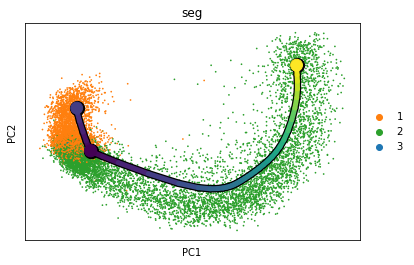

In [8]:
run_pseudotime(adata, root=81, n_maps=1)

In [9]:
adata.obs

,X_TC_alpha,total_TC_alpha,unspliced_TC_alpha,spliced_TC_alpha,p_e,p_c_TC,sample,timepoint,rep,n_genes_by_counts,...,MN_score,V3_score,mesoderm_score,marker_based_classification,cell_annotation,cell_annotation_detailed,t,seg,edge,milestones
MAI5081A677_TGAAGATGGA,0.147144,0.146391,0.148150,0.146781,0.000142,0.005865,MAI5081A677,D3,r1,6096,...,0.356264,0.650529,-0.164385,null_neuron,MN,earlier_MN_trajectory,13.683598,2,23|13,24
MAI5081A765_AGTGACCACG,0.333166,0.323656,0.319808,0.332023,0.000142,0.016062,MAI5081A765,D3,r1,5214,...,0.311221,0.568609,-0.221378,null_mixed2,MN,earlier_MN_trajectory,37.602572,2,53|64,62
MAI5081A391_ACTTACCGGC,0.344214,0.341290,0.342194,0.343130,0.000142,0.015746,MAI5081A391,D4,r1,5042,...,0.559863,1.332455,-0.213758,Motorneuron,MN,earlier_MN_trajectory,17.471954,2,42|58,24
MAI5081A460_GCTATTGAAG,0.223392,0.214874,0.201489,0.222539,0.000142,0.009500,MAI5081A460,D4,r1,5117,...,-0.158350,-0.311812,-0.055652,pMN,pMN,early_pMN,0.194838,2,96|75,24
MAI5081A442_GTACTTCCAA,0.269948,0.265500,0.265015,0.269283,0.000142,0.012888,MAI5081A442,D4,r1,3953,...,0.302062,0.210536,-0.069797,pMN,MN,earlier_MN_trajectory,8.013038,2,54|30,24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MAI5081A2718_CTGCATAGCA,0.430885,0.435824,0.456705,0.429596,0.000142,0.020139,MAI5081A2718,D3.8,r4,5204,...,0.329222,0.688702,-0.114984,Motorneuron,MN,earlier_MN_trajectory,7.989496,2,54|30,24
MAI5081A3015_TACCAGAGAT,0.348333,0.354439,0.369958,0.347444,0.000142,0.015321,MAI5081A3015,D3.8,r4,5316,...,0.105463,0.154466,-0.129961,null_neuron,MN,earlier_MN_trajectory,7.830109,2,54|30,24
MAI5081A2984_GCAATTGTGG,0.433486,0.435190,0.447550,0.434171,0.000142,0.020192,MAI5081A2984,D3.8,r4,5691,...,0.390071,0.736110,-0.145534,Motorneuron,MN,earlier_MN_trajectory,7.961089,2,54|30,24
MAI5081A2995_CCGAACGTTC,0.437456,0.442991,0.459933,0.437151,0.000142,0.020896,MAI5081A2995,D3.8,r4,4356,...,0.084125,0.117399,-0.130526,pMN,MN,earlier_MN_trajectory,15.704825,2,60|32,24


In [10]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 10180/10180 [00:41<00:00, 246.49it/s]


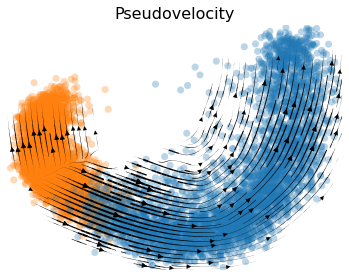

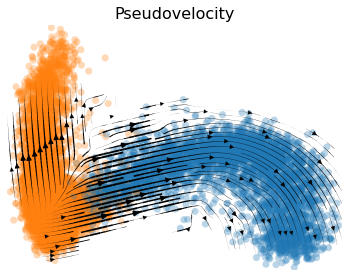

In [12]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [13]:
calculate_cellrank_vectorfield(adata)

  0%|          | 0/10180 [00:00<?, ?cell/s]

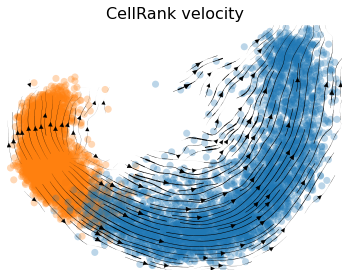

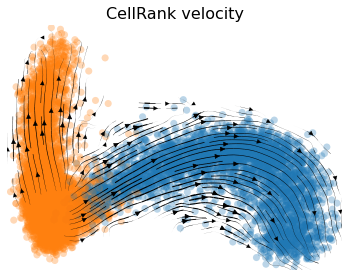

In [14]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [19]:
adata.write_h5ad("../data/benchmarking_data/mini_MN.h5ad")

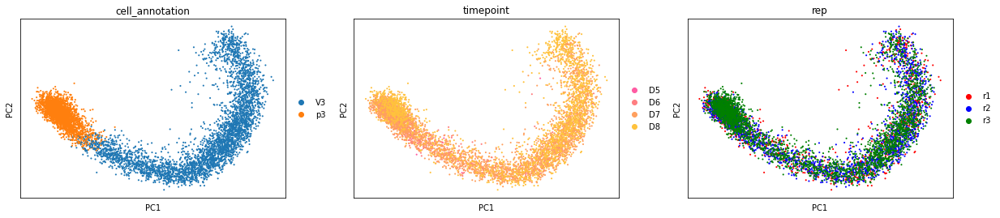

In [22]:
### 2. V3

types = ['V3', 'p3']

adata = adata0[[ct in types for ct in adata0.obs.cell_annotation]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total')

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

inferring a principal tree --> parameters used 
    200 principal points, sigma = 2, lambda = 100, metric = euclidean
    fitting:  22%|██▏       | 65/300 [00:14<00:54,  4.34it/s]
    converged
    finished (0:00:15) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.
Tips: [  9  75 117]

Forks: [83]


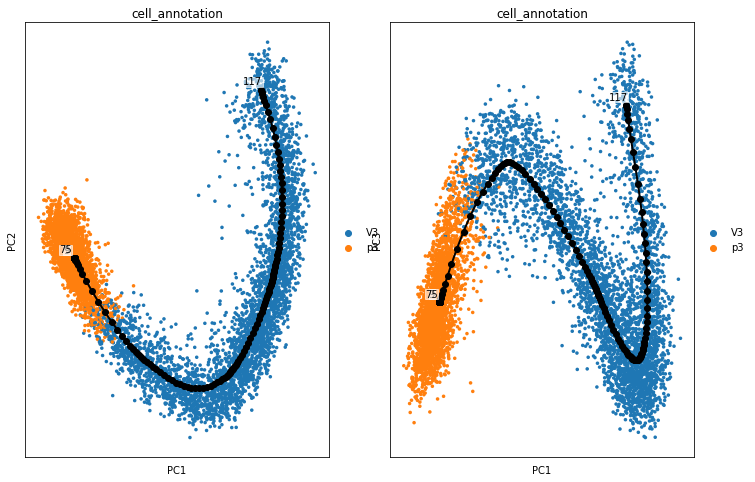

In [23]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=100,
    ppt_sigma=2,
    ndims_rep=50,
    figsize=(12,8)
)

node 75 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [00:53<00:00,  5.31s/it]
    finished (0:00:59) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


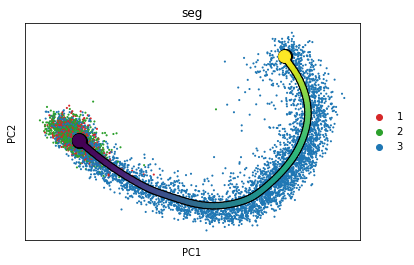

In [24]:
run_pseudotime(adata, root=75)

In [25]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 6798/6798 [00:26<00:00, 257.74it/s]


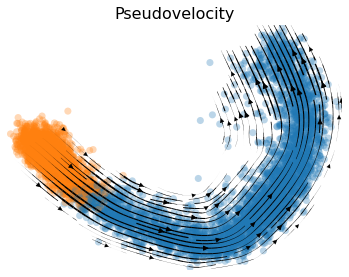

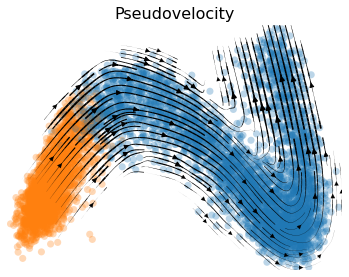

In [26]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [27]:
calculate_cellrank_vectorfield(adata)

  0%|          | 0/6798 [00:00<?, ?cell/s]

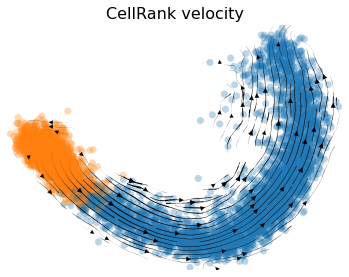

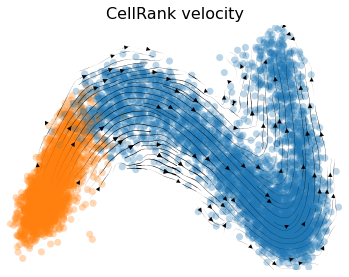

In [28]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [29]:
adata

AnnData object with n_obs × n_vars = 6798 × 1315
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'leiden', 'NMP_score', 'early_neural_score', 'pMN_score', 'p3_score', 'MN_score', 'V3_score', 'mesoderm_score', 'marker_based_classification', 'cell_annotation', 'cell_annotation_detailed', 't', 'seg', 'edge', 't_sd', 'milestones'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'rep_colors', 'timepoint_colors', 'cell_annotation_colors', 'graph', 'ppt', 'pseudotime_list', 'milestones_colors', 'seg_colors', 'velocity_params', 'velocity_cr_params'
    obsm: 'X_pca', 'X_pca_smooth', 'X_R', 'velocity_pst', 'X_pst', 'velocity_cr_pca', 'X_cr_pca'
    varm: 'precomputed_PCs'
    layers: 'new', 'old', 'total'
    obsp: 'neighbors_connectivities'

In [30]:
adata.write_h5ad("../data/benchmarking_data/mini_V3.h5ad")

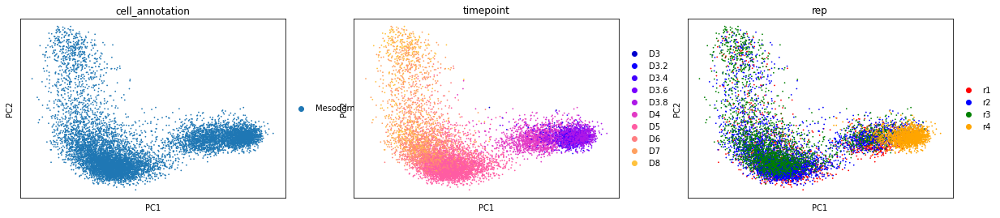

In [31]:
### 3. MD

types = ['Mesoderm']

adata = adata0[[ct in types for ct in adata0.obs.cell_annotation]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total')

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])


inferring a principal tree --> parameters used 
    200 principal points, sigma = 2, lambda = 100, metric = euclidean
    fitting:  60%|██████    | 181/300 [00:22<00:14,  7.97it/s]
    converged
    finished (0:00:22) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.
Tips: [47 78 92]

Forks: [17]


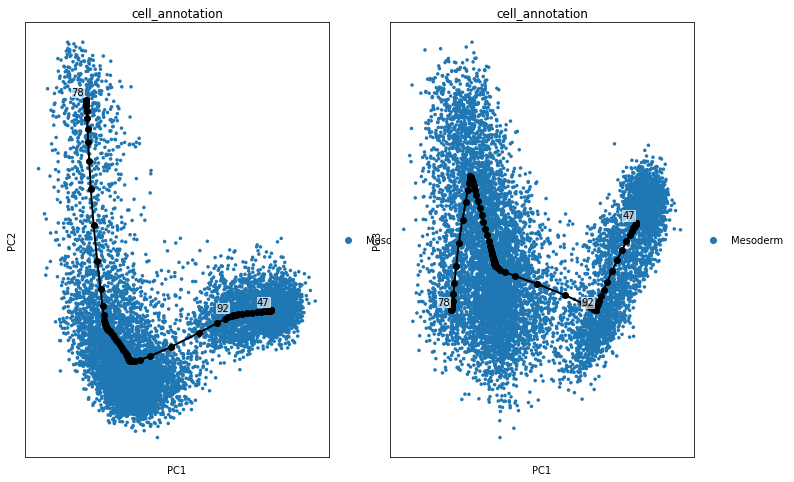

In [32]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=100,
    ppt_sigma=2,
    ndims_rep=50,
    figsize=(12,8)
)

node 47 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [00:48<00:00,  4.81s/it]
    finished (0:00:54) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


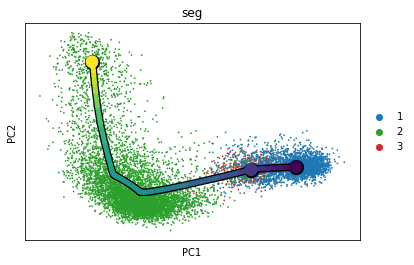

In [33]:
run_pseudotime(adata, root=47)

In [34]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 9786/9786 [00:38<00:00, 256.41it/s]


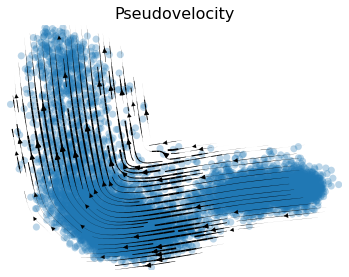

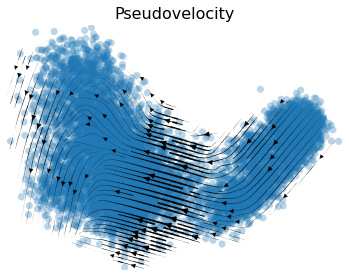

In [35]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [36]:
calculate_cellrank_vectorfield(adata)

  0%|          | 0/9786 [00:00<?, ?cell/s]

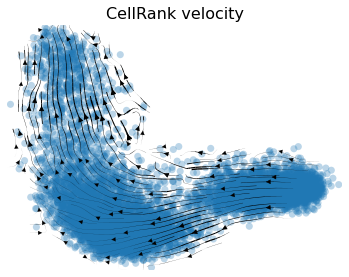

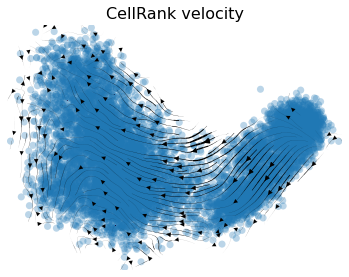

In [37]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [38]:
adata

AnnData object with n_obs × n_vars = 9786 × 1174
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'leiden', 'NMP_score', 'early_neural_score', 'pMN_score', 'p3_score', 'MN_score', 'V3_score', 'mesoderm_score', 'marker_based_classification', 'cell_annotation', 'cell_annotation_detailed', 't', 'seg', 'edge', 't_sd', 'milestones'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'rep_colors', 'timepoint_colors', 'cell_annotation_colors', 'graph', 'ppt', 'pseudotime_list', 'milestones_colors', 'seg_colors', 'velocity_params', 'velocity_cr_params'
    obsm: 'X_pca', 'X_pca_smooth', 'X_R', 'velocity_pst', 'X_pst', 'velocity_cr_pca', 'X_cr_pca'
    varm: 'precomputed_PCs'
    layers: 'new', 'old', 'total'
    obsp: 'neighbors_connectivities'

In [40]:
adata.write_h5ad("../data/benchmarking_data/mini_MD.h5ad")

### 2. Midi

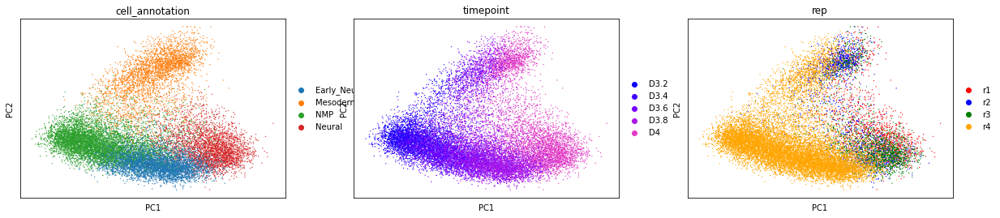

In [41]:
### 1. NM

nt_types = ['MN', 'V3', 'p3','pMN']

adata = adata0[[ct not in nt_types for ct in adata0.obs.cell_annotation]]
adata = adata[[tp not in ['D3','D5','D6','D7','D8'] for tp in adata.obs.timepoint]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total', n_neighbors=200, )

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

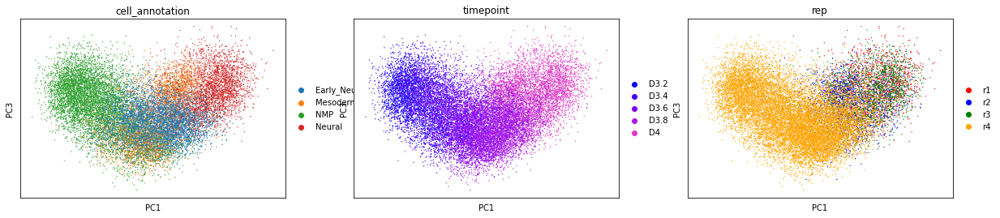

In [42]:
sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'], components='1,3')

inferring a principal tree --> parameters used 
    200 principal points, sigma = 1.7, lambda = 200, metric = euclidean
    fitting:  13%|█▎        | 38/300 [00:08<01:00,  4.37it/s]
    converged
    finished (0:00:08) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.
Tips: [ 65  73  99 150]

Forks: [ 58 120]


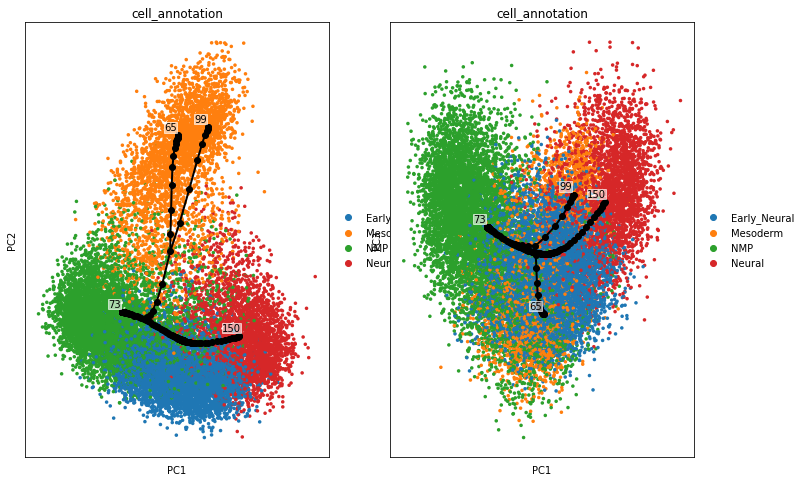

In [43]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=200,
    ppt_sigma=1.7,
    ndims_rep=50,
    figsize=(12,8)
)

node 73 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [00:24<00:00,  2.43s/it]
    finished (0:00:36) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


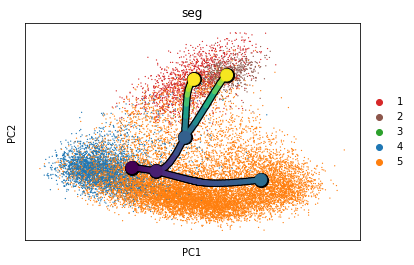

In [44]:
run_pseudotime(adata, root=73)

In [45]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 18341/18341 [01:12<00:00, 254.59it/s]


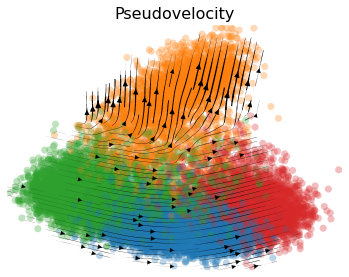

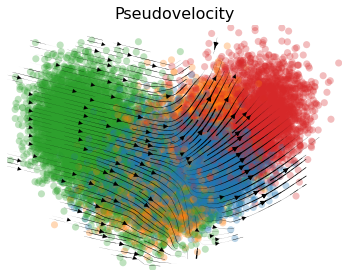

In [46]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [47]:
calculate_cellrank_vectorfield(adata)

  0%|          | 0/18341 [00:00<?, ?cell/s]

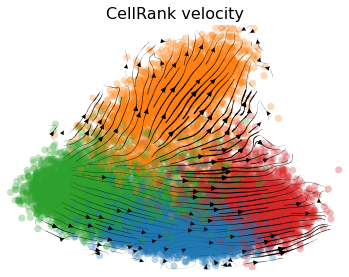

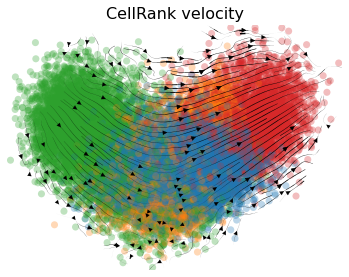

In [48]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [49]:
adata

AnnData object with n_obs × n_vars = 18341 × 1170
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'leiden', 'NMP_score', 'early_neural_score', 'pMN_score', 'p3_score', 'MN_score', 'V3_score', 'mesoderm_score', 'marker_based_classification', 'cell_annotation', 'cell_annotation_detailed', 't', 'seg', 'edge', 't_sd', 'milestones'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'rep_colors', 'timepoint_colors', 'cell_annotation_colors', 'graph', 'ppt', 'pseudotime_list', 'milestones_colors', 'seg_colors', 'velocity_params', 'velocity_cr_params'
    obsm: 'X_pca', 'X_pca_smooth', 'X_R', 'velocity_pst', 'X_pst', 'velocity_cr_pca', 'X_cr_pca'
    varm: 'precomputed_PCs'
    layers: 'new', 'old', 'total'
    obsp: 'neighbors_connectivities'

In [50]:
adata.write_h5ad("../data/benchmarking_data/midi_NM.h5ad")

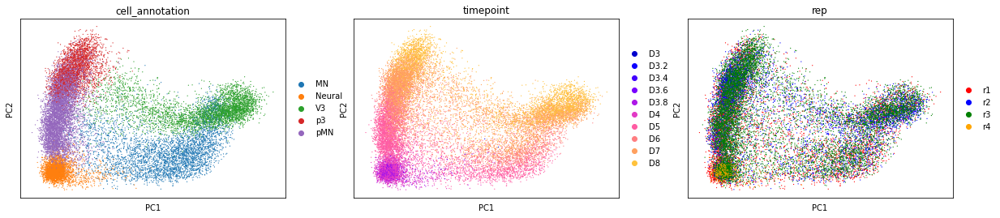

In [51]:
#### 2. Ne
types = ['MN','Neural', 'pMN', 'V3', 'p3']

adata = adata0[[ct in types for ct in adata0.obs.cell_annotation]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total', n_neighbors=200)

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

inferring a principal tree --> parameters used 
    200 principal points, sigma = 2.2, lambda = 800, metric = euclidean
    fitting:  11%|█         | 33/300 [00:09<01:16,  3.51it/s]
    converged
    finished (0:00:09) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.
Tips: [24 32 48 54 87 90]

Forks: [ 94 147 174 195]


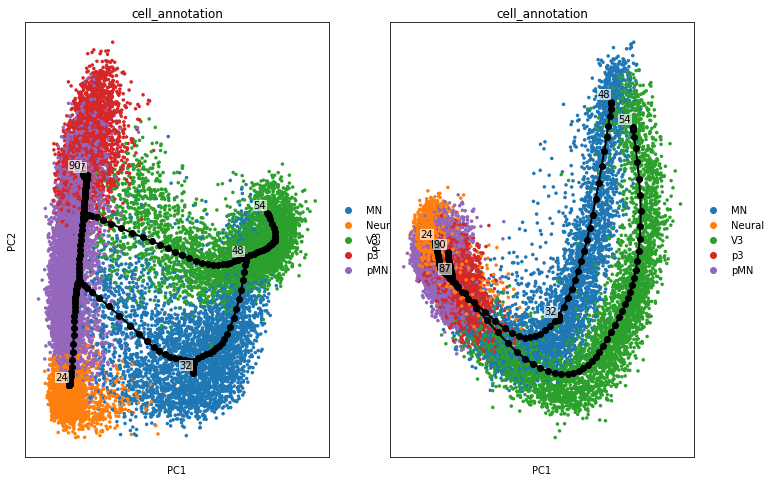

In [52]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=800,
    ppt_sigma=2.2,
    ndims_rep=50,
    figsize=(12,8)
)

node 24 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [01:01<00:00,  6.14s/it]
    finished (0:01:17) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


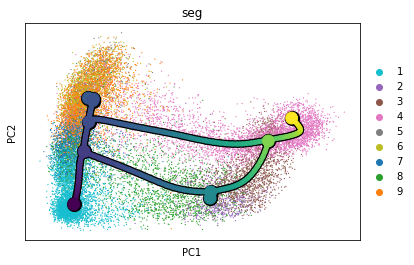

In [53]:
run_pseudotime(adata, root=24)

In [54]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 20163/20163 [01:17<00:00, 261.23it/s]


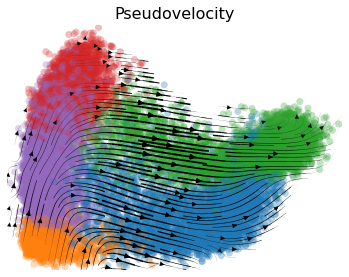

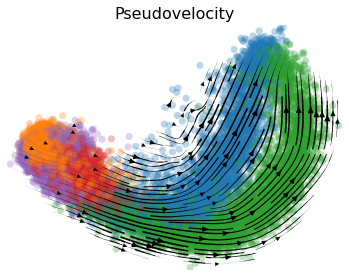

In [55]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [56]:
calculate_cellrank_vectorfield(adata)

  0%|          | 0/20163 [00:00<?, ?cell/s]

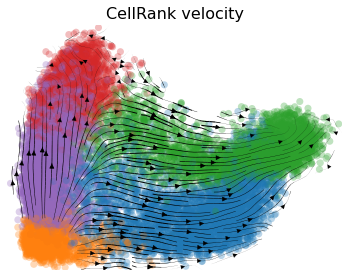

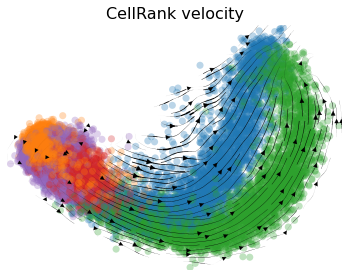

In [57]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [58]:
adata.write_h5ad("../data/benchmarking_data/midi_Ne.h5ad")

### maxi

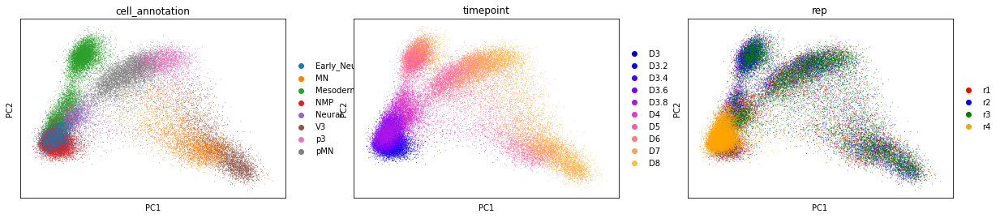

In [59]:
adata = adata0.copy()

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total', n_neighbors=200)

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

inferring a principal tree --> parameters used 
    200 principal points, sigma = 2.25, lambda = 400, metric = euclidean
    fitting:  35%|███▍      | 104/300 [00:54<01:42,  1.91it/s]
    converged
    finished (0:00:55) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.
Tips: [ 32  89 122 143 198]

Forks: [ 84 162 186]


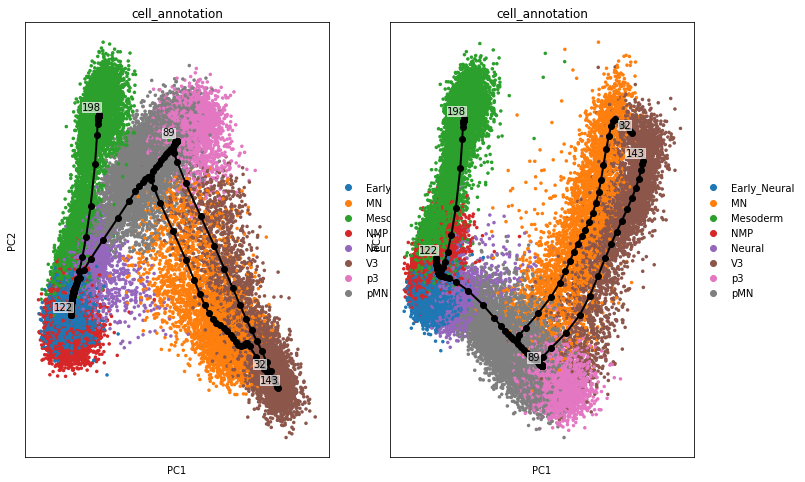

In [60]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=400,
    ppt_sigma=2.25,
    ndims_rep=50,
    figsize=(12,8)
)

node 122 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [01:41<00:00, 10.16s/it]
    finished (0:02:16) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


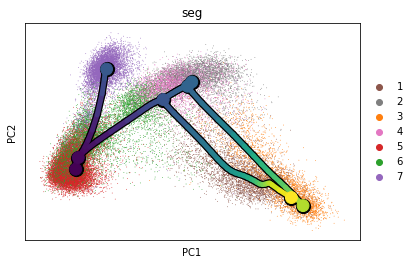

In [61]:
run_pseudotime(adata, root=122)

In [55]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 45037/45037 [02:08<00:00, 350.21it/s]


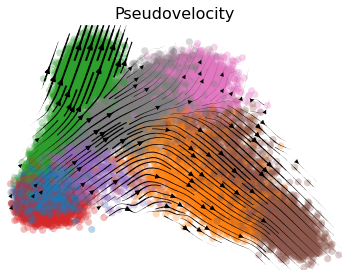

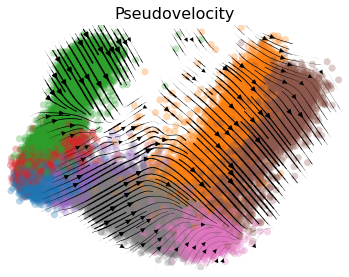

In [58]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [57]:
vt.pl.velocity_3d(adata, basis='pst')

This doesn't look good enough to use, but maybe the cellrank transition matrix from pseudotime will work better...

In [62]:
calculate_cellrank_vectorfield(adata)

  0%|          | 0/45037 [00:00<?, ?cell/s]

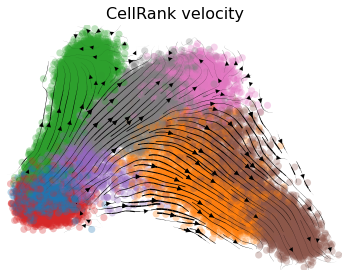

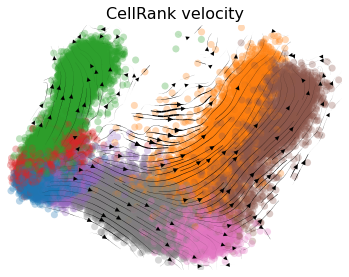

In [63]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

that looks much better, we can use that.

In [64]:
# del adata.obsm['velocity_pst']
# del adata.obsm['X_pst']

In [64]:
adata.write_h5ad("../data/benchmarking_data/maxi.h5ad")